# Persistence Analysis

In [2]:
import matplotlib
from matplotlib.colors import to_hex
import matplotlib.pyplot as plt
import numpy as np
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import DBSCAN
from sklearn.mixture import BayesianGaussianMixture
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from pylab import *
from matplotlib import rc
import matplotlib.ticker as ticker
import seaborn as sn
import folium

from Wind.Util import find_exp, count_exp, sel_result
from Wind.Config.Paths import wind_data_path

cpal = plt.get_cmap('Reds')

coords = np.load(wind_data_path +'/coords.npy')

import plotly.offline as py
import pandas as pd

%matplotlib notebook

/usr/lib64/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)


In [15]:
query1= {'status':'done', "experiment": "Persistence", "site": {"$regex":"."}}

count_exp(query1)
res1 = find_exp(query1)
sites1, coord1 = sel_result(res1,1)

valsum = np.sum(coord1,axis=1)
minsum = np.min(valsum)
rangesum = np.max(valsum) - minsum

126546


In [ ]:
sn.set_style("whitegrid")
fig = plt.figure(figsize=(16, 8), dpi=100)
axes = fig.add_subplot(1, 1, 1)
axes.set_title('Persistence R^2 sum')
sn.distplot(valsum);

In [ ]:
# mymap = folium.Map(location=[coords[sites1[0],0], coords[sites1[0],1]], zoom_start=6, width=1000,
#                    height=700,tiles='Stamen Terrain')

# for i, e in zip(sites1,coord1):
#     if i < coords.shape[0]:
#         folium.features.CircleMarker(
#             radius=10,
#             location=[coords[i,0], coords[i,1]],
#             color='#FFFFFF00',
#             fill=True,
#             fill_color=to_hex(cpal((np.sum(e)-minsum)/rangesum)),
#             fill_opacity=1
#         ).add_to(mymap)
    
# mymap

In [16]:

# df = pd.DataFrame({'Lat': coords[sites1,0], 'Lon': coords[sites1,1], 'Val':(np.sum(coord1, axis=1)-minsum)/rangesum })
df = pd.DataFrame({'Lat': np.append(coords[sites1,0],[0,0]), 'Lon': np.append(coords[sites1,1],[0,0]), 'Val':np.append(np.sum(coord1, axis=1),[12,-7])})

scl = [0,"rgb(150,0,90)"],[0.125,"rgb(0, 0, 200)"],[0.25,"rgb(0, 25, 255)"],\
[0.375,"rgb(0, 152, 255)"],[0.5,"rgb(44, 255, 150)"],[0.625,"rgb(151, 255, 0)"],\
[0.75,"rgb(255, 234, 0)"],[0.875,"rgb(255, 111, 0)"],[1,"rgb(255, 0, 0)"]

data = [ dict(
    lat = df['Lat'],
    lon = df['Lon'],
    text = df['Val'].astype(str),
    marker = dict(
        color = df['Val'],
        colorscale = scl,
        reversescale = True,
        opacity = 0.7,
        size = 2,
        colorbar = dict(
            thickness = 10,
            titleside = "right",
            outlinecolor = "rgba(68, 68, 68, 0)",
            ticks = "outside",
            ticklen = 3,
            showticksuffix = "last",
            ticksuffix = " ",
            dtick = 2
        ),
    ),
    type = 'scattergeo'
) ]



layout = dict(
    geo = dict(
        scope = 'north america',
        showland = True,
        landcolor = "rgb(212, 212, 212)",
        subunitcolor = "rgb(255, 255, 255)",
        countrycolor = "rgb(255, 255, 255)",
        showlakes = True,
        lakecolor = "rgb(255, 255, 255)",
        showsubunits = True,
        showcountries = True,
        resolution = 50,
        projection = dict(
            type = 'conic conformal',
            rotation = dict(
                lon = -100
            )
        ),
        lonaxis = dict(
            showgrid = True,
            gridwidth = 0.5,
            range= [ -140.0, -55.0 ],
            dtick = 5
        ),
        lataxis = dict (
            showgrid = True,
            gridwidth = 0.5,
            range= [ 20.0, 60.0 ],
            dtick = 5
        )
    ),
    width=1200,
    height=800,
    title = 'persistence',
)
fig = { 'data':data, 'layout':layout }
py.init_notebook_mode(connected=True)

py.iplot(fig, filename='persistence.html')

In [ ]:
pca = PCA()

ncoord1 = pca.fit_transform(coord1)

In [ ]:
fig = plt.figure(figsize=(8, 5), dpi=100)

ax = fig.add_subplot(111, projection='3d')
plt.scatter(ncoord1[:, 0], ncoord1[:, 1], zs=ncoord1[:, 2], depthshade=False, s=100)
plt.show()

In [ ]:
#dbs = DBSCAN(eps=0.1, min_samples=10)
dbs = BayesianGaussianMixture(2, max_iter=1000)

dbs.fit(ncoord1)
labels1 = dbs.predict(ncoord1)

print(np.unique(labels1))
ncl = len(np.unique(labels1))

fig = plt.figure(figsize=(8, 5), dpi=100)

ax = fig.add_subplot(111, projection='3d')
plt.scatter(ncoord1[:, 0], ncoord1[:, 1], zs=ncoord1[:, 2], c=[(l+1.0)/ncl for l in labels1], cmap=cpal, depthshade=False, s=100)
plt.show()

In [ ]:

# mymap = folium.Map(location=[coords[sites1[0],0], coords[sites1[0],1]], zoom_start=6, width=1000,
#                    height=700,tiles='Stamen Terrain')

# for i, e in zip(sites1,[(l+1.0)/ncl for l in labels1]):
#     folium.features.CircleMarker(
#         radius=10,
#         location=[coords[i,0], coords[i,1]],
#         color='#FFFFFF00',
#         fill=True,
#         fill_color=to_hex(cpal(e)),
#         fill_opacity=1
#     ).add_to(mymap)
    
# mymap

# MLP multiple regression

In [17]:
query1= {'status':'done', "experiment": "mlpregs2s", "site": {"$regex":"."}}

count_exp(query1)
res1 = find_exp(query1)
sites1, coord1 = sel_result(res1,1)

valsum = np.sum(coord1,axis=1)
minsum = np.min(valsum)
rangesum = np.max(valsum) - minsum

15179


/usr/lib64/python3.6/site-packages/scipy/stats/stats.py:1706: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.

/usr/local/lib64/python3.6/site-packages/matplotlib/axes/_axes.py:6462: UserWarning:

The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.



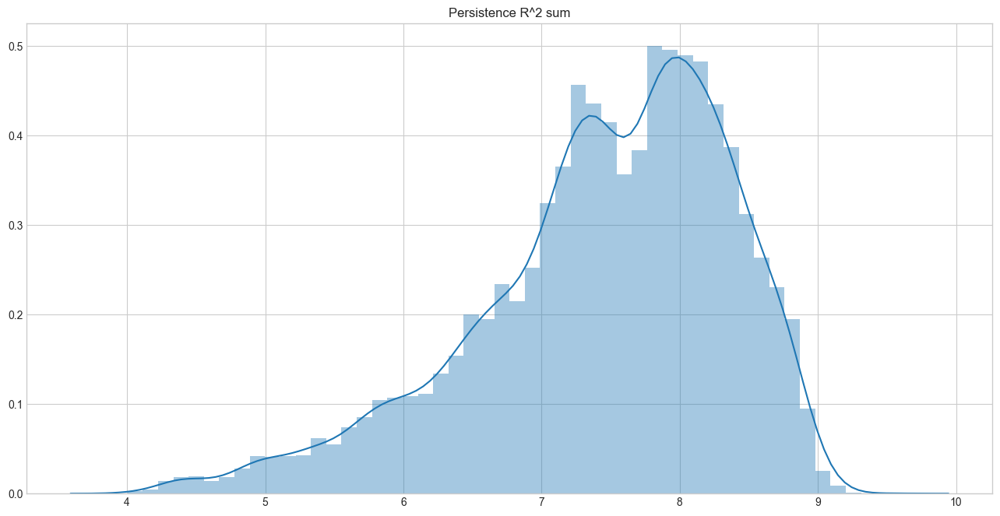

In [7]:
sn.set_style("whitegrid")
fig = plt.figure(figsize=(16, 8), dpi=100)
axes = fig.add_subplot(1, 1, 1)
axes.set_title('Persistence R^2 sum')
sn.distplot(valsum);

In [ ]:
# mymap = folium.Map(location=[coords[sites1[0],0], coords[sites1[0],1]], zoom_start=6, width=1000,
#                    height=700,tiles='Stamen Terrain')

# for i, e in zip(sites1,coord1):
#     if i < coords.shape[0]:
#         folium.features.CircleMarker(
#             radius=10,
#             location=[coords[i,0], coords[i,1]],
#             color='#FFFFFF00',
#             fill=True,
#             fill_color=to_hex(cpal((np.sum(e)-minsum)/rangesum)),
#             fill_opacity=1
#         ).add_to(mymap)
    
# mymap

In [18]:

# df = pd.DataFrame({'Lat': coords[sites1,0], 'Lon': coords[sites1,1], 'Val':(np.sum(coord1, axis=1)-minsum)/rangesum })
df = pd.DataFrame({'Lat': np.append(coords[sites1,0],[0,0]), 'Lon': np.append(coords[sites1,1],[0,0]), 'Val':np.append(np.sum(coord1, axis=1),[12,-7])})

scl = [0,"rgb(150,0,90)"],[0.125,"rgb(0, 0, 200)"],[0.25,"rgb(0, 25, 255)"],\
[0.375,"rgb(0, 152, 255)"],[0.5,"rgb(44, 255, 150)"],[0.625,"rgb(151, 255, 0)"],\
[0.75,"rgb(255, 234, 0)"],[0.875,"rgb(255, 111, 0)"],[1,"rgb(255, 0, 0)"]

data = [ dict(
    lat = df['Lat'],
    lon = df['Lon'],
    text = df['Val'].astype(str),
    marker = dict(
        color = df['Val'],
        colorscale = scl,
        reversescale = True,
        opacity = 0.7,
        size = 2,
        colorbar = dict(
            thickness = 10,
            titleside = "right",
            outlinecolor = "rgba(68, 68, 68, 0)",
            ticks = "outside",
            ticklen = 3,
            showticksuffix = "last",
            ticksuffix = " ",
            dtick = 2
        ),
    ),
    type = 'scattergeo'
) ]



layout = dict(
    geo = dict(
        scope = 'north america',
        showland = True,
        landcolor = "rgb(212, 212, 212)",
        subunitcolor = "rgb(255, 255, 255)",
        countrycolor = "rgb(255, 255, 255)",
        showlakes = True,
        lakecolor = "rgb(255, 255, 255)",
        showsubunits = True,
        showcountries = True,
        resolution = 50,
        projection = dict(
            type = 'conic conformal',
            rotation = dict(
                lon = -100
            )
        ),
        lonaxis = dict(
            showgrid = True,
            gridwidth = 0.5,
            range= [ -140.0, -55.0 ],
            dtick = 5
        ),
        lataxis = dict (
            showgrid = True,
            gridwidth = 0.5,
            range= [ 20.0, 60.0 ],
            dtick = 5
        )
    ),
    width=1200,
    height=800,
    title = 'MLP Seq2seg regression',
)
fig = { 'data':data, 'layout':layout }
py.init_notebook_mode(connected=True)
py.iplot(fig, filename='MLPRegS2S.html')